# EEG reading and pass to nifti

This notebook corresponds to the section titled **"Preparation of EEG Data"** and uses the `eeg_data_preparation` function from the `MEEG_fMRI_whole_compa_script.py` script.

In this notebook, EEG data is converted from source estimate files to NIFTI format through interpolation using the function `interpolate_sestim_to_voxel_space` from `eeg_utils.py`, enabling direct comparison with fMRI data. The EEG data is then thresholded at a user-defined top percentile alpha level and subjected to a minimum cluster size criterion. Additionally, visualizations of the conditions are provided after thresholding step.

## Import the necessary libraries

In [1]:
import nibabel as nib
from pathlib import Path
import glob
import numpy as np
import sys
import time
import matplotlib.pyplot as plt
import logging

from nilearn.plotting import plot_stat_map
from nilearn.image import resample_img
from nilearn.glm import threshold_stats_img
from nilearn.maskers import NiftiMasker

from pycartool.spi import read_spi 
from pycartool.ris import read_ris

# Personal Imports
# Add the directory that contains the utils package to sys.path
sys.path.append(str(Path('..').resolve()))
from utils.utils import setup_logging, trackprogress
from utils.eeg_utils import *
from utils.window_utils import get_max_index, get_poa_timepoint_sestim
from utils.mask_utils import process_ribbon
from utils.threshold_utils import find_top_alpha_percent_threshold, resample_and_threshold_image

## Path to the dataset

Before running the notebooks, make sure to update the path in `config.py` to match your local setup.
- **`LOCAL_DIR`**: Set this to the directory where the BIDS-formatted data will be stored.

In [2]:
from config import LOCAL_DIR
local_dir = LOCAL_DIR

## Get the subjects names for this study

**Subject Exclusions and Issues:**

- **Subjects 1 and 2**: Excluded from analysis because their results in the native space are not available.
- **Subject 11**: Removed due to issues encountered during data acquisitions.
- **Subject 10**: Not available.

In [3]:
# Create a list of subjects from 'sub-03' to 'sub-17'
subjects = [f"sub-{i:02}" for i in range(3, 18) if i not in [11, 10]]

# Print the updated list to verify
print(subjects)

['sub-03', 'sub-04', 'sub-05', 'sub-06', 'sub-07', 'sub-08', 'sub-09', 'sub-12', 'sub-13', 'sub-14', 'sub-15', 'sub-16', 'sub-17']


## Define the tasks and contrasts

`tasks_conditions` is a dictionary that maps each task to its corresponding conditions.

In `task_tp`, windows are defined for each task, and occasionally for specific conditions within the task. To update these settings, refer to the `config.py` file. The windows are intended to be time-locked around the peaks of activation triggered by the conditions.

In [4]:
# Map each task to its corresponding contrast of interest
from config import TASKS_CONDITIONS, EEG_TASKS_TP
tasks_conditions = TASKS_CONDITIONS

# Specify timepoints for each task to be converted into NIfTI format for comparison with other modalities
task_tp = EEG_TASKS_TP

## Read a source estimate file and transfrom into a nifti file in the MRI space

At the beginning, in the `thres_param` dictionnary, you can set the parameter `alpha`, which determines the top percentile of values to retain after thresholding. You can also specify the minimum cluster size using the `cluster_thres` parameter. This variable correspond to `THRES_PARAM` in `config.py`. By modifying the `EEG_STC_ALGO` variable in `config.py`, you can select the algorithm used to compute the source estimates.

The steps in the following cell for each subject are as follows:

1. **Load the Source Space:**
   - Load the source space data for the subject.

2. **Load or Generate the Brain Mask:**
   - Load the brain mask resampled to the fMRI space.
   - If the resampled brain mask is not available, generate it from the anatomical data.

For each task and condition:

1. **Load the Source Estimate File:**
   - Load the source estimate file corresponding to the task and condition.

For each time window of the task:

1. **Identify the Maximum Activation Timepoint:**
   - Find the time point corresponding to the maximum activation within the window.

2. **Interpolate Source Estimates:**
   - Interpolate the source estimates at the identified time point into the anatomical T1 image space.

3. **Resample to fMRI Space:**
   - Resample the interpolated source estimates to match the fMRI space resolution.

4. **Apply Brain Mask:**
   - Mask the resampled image using the brain mask to exclude non-brain areas.

5. **Determine the Threshold:**
   - Calculate the threshold value that retains the top `alpha * 100` percent of the activation values.

6. **Threshold the Interpolation Map:**
   - Apply the threshold to the interpolation map in the fMRI space.

For each step, a NIfTI file is saved to document the processed data.


In [5]:
# Define thresholding parameters
thres_param = {
    'EEG': {'alpha': 0.01, 'cluster_thresh': 15}
}

from config import EEG_STC_ALGO
stc_algo = EEG_STC_ALGO

In [6]:
# Setup logging
logger = setup_logging(local_dir, 'logger-eeg_stc2nifti_notebook')

The following cells correspond to the `eeg_data_stc2nifti` function from `eeg_utils.py`, including additional plotting functionality.

Processing sub-03
0.00 % completed
  
Analysis of task aud
[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-03\eeg-esi\sub-03_task-aud_proc-raw_EEG_20240301_11092_sine.icacorr.SpatialFilter.LAURA 8944 RGV.ZScoreVN.Vectorial Mean 65.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8944
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


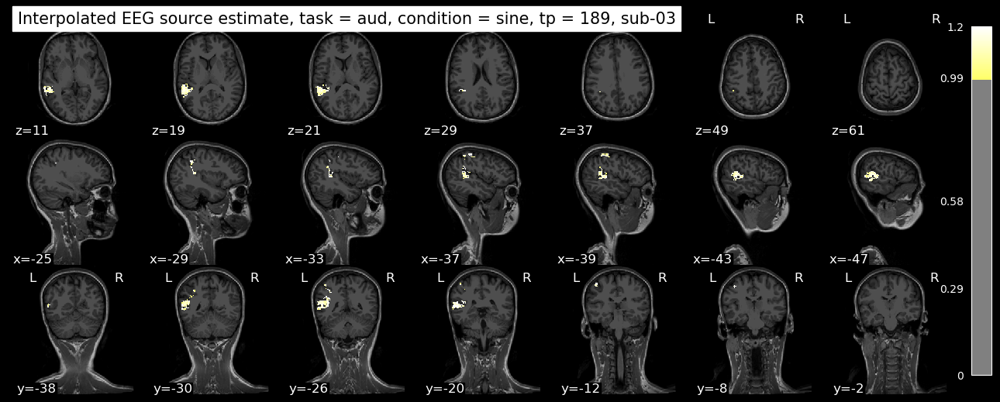

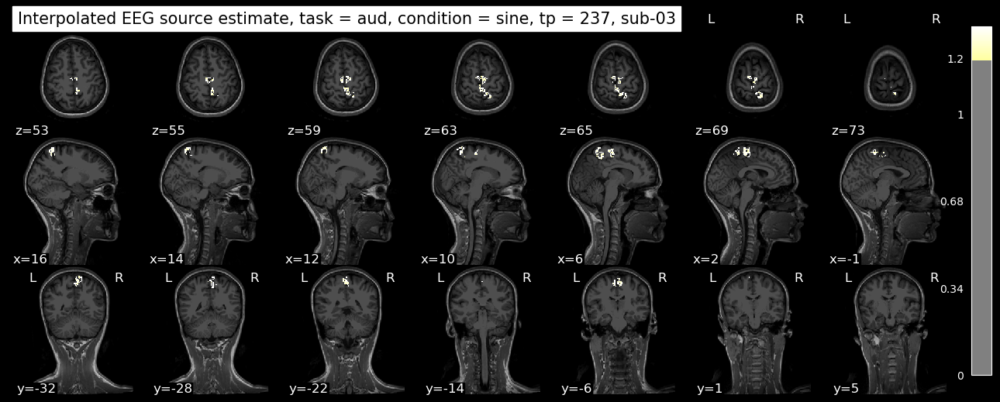

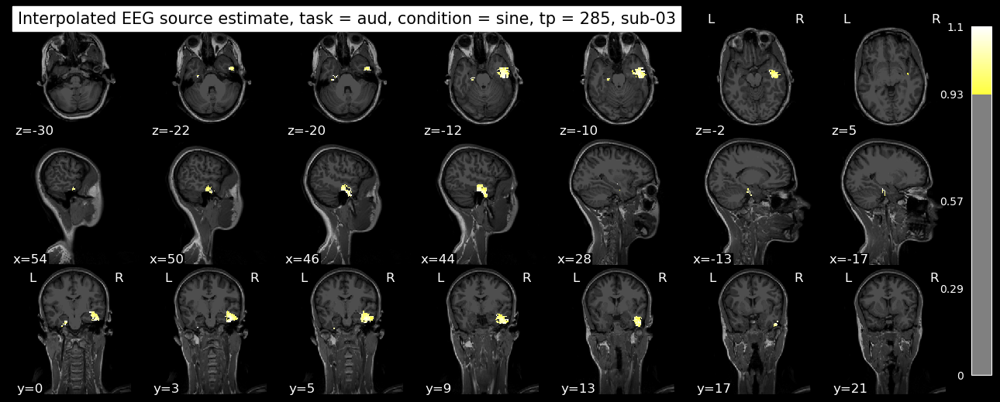

[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-03\eeg-esi\sub-03_task-aud_proc-raw_EEG_20240301_11092_piano1.icacorr.SpatialFilter.LAURA 8944 RGV.ZScoreVN.Vectorial Mean 70.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8944
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


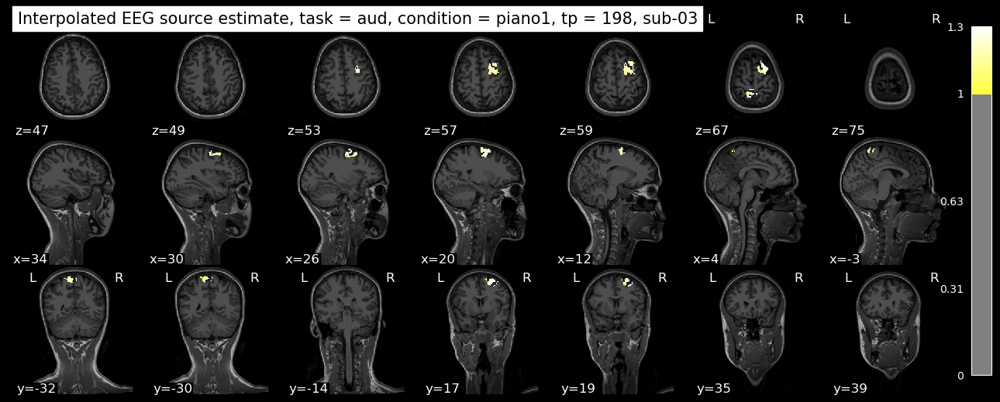

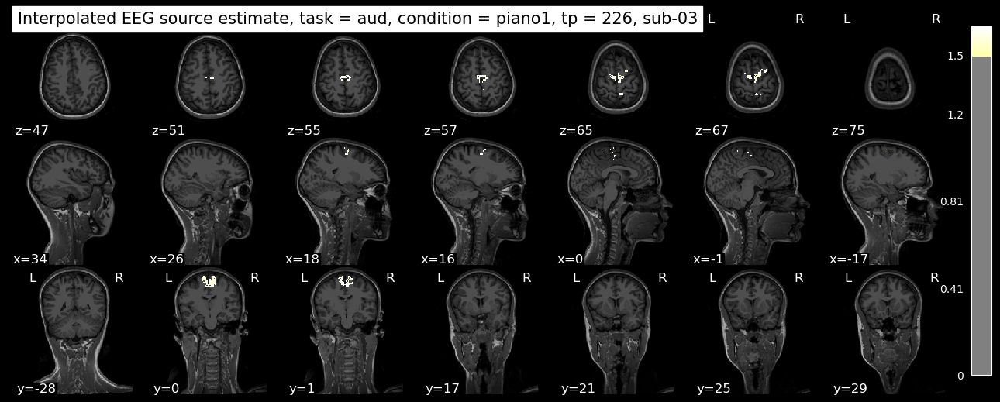

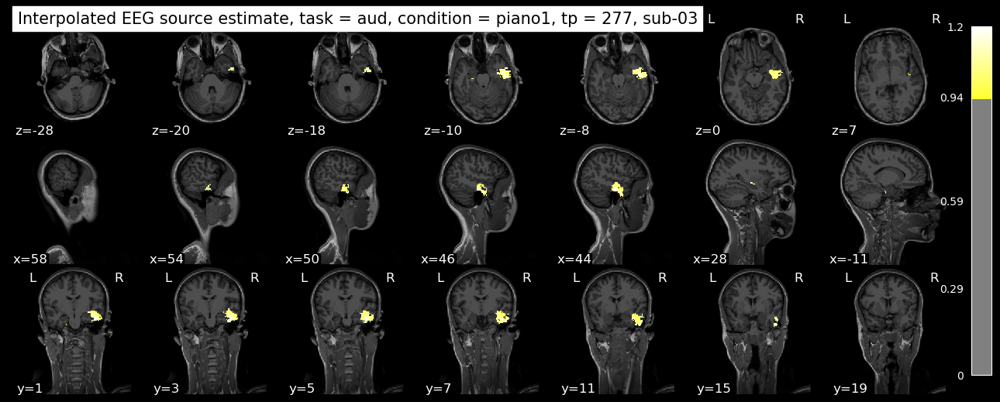

[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-03\eeg-esi\sub-03_task-aud_proc-raw_EEG_20240301_11092_piano4.icacorr.SpatialFilter.LAURA 8944 RGV.ZScoreVN.Vectorial Mean 69.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8944
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


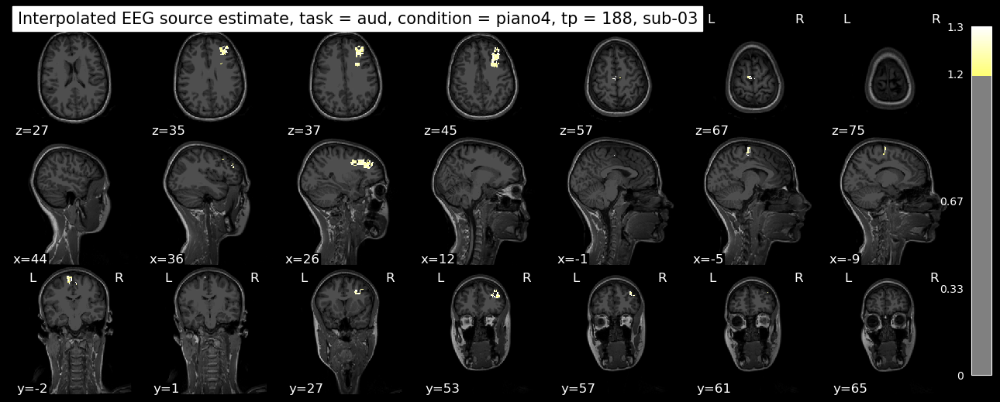

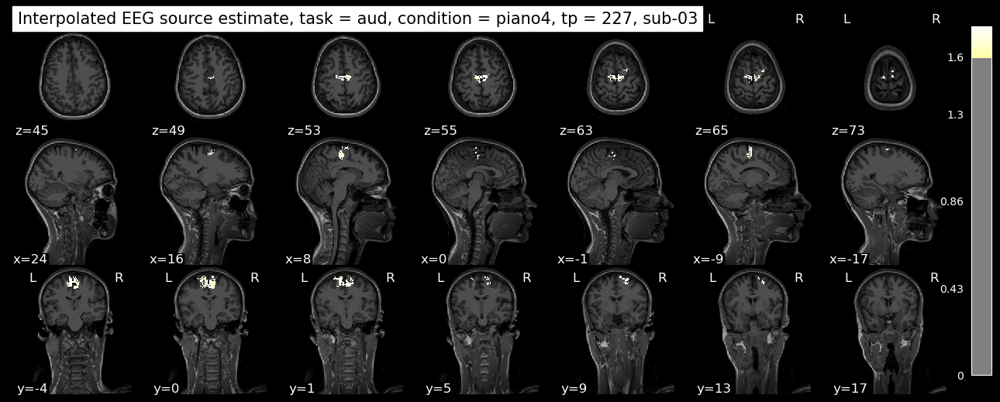

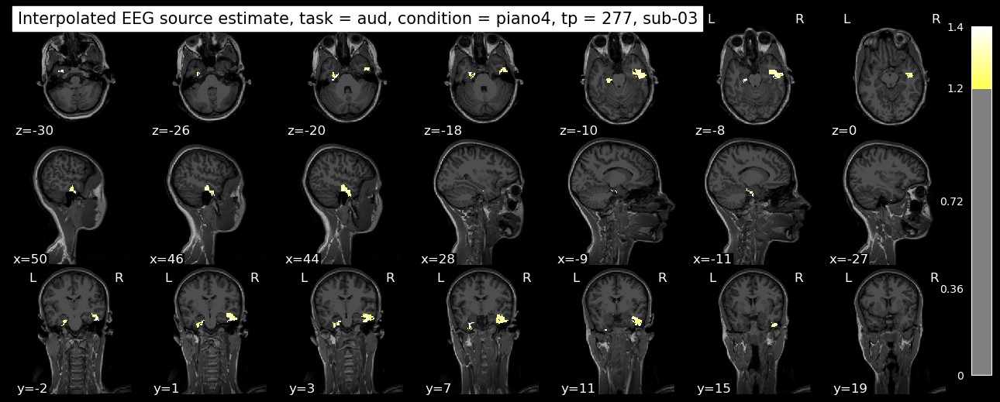

  
Analysis of task feet
[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-03\eeg-esi\sub-03_task-feet_proc-raw_EEG_20240301_11285_leftfoot.icacorr.SpatialFilter.LAURA 8944 RGV.ZScoreVN.Vectorial Mean 110.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8944
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


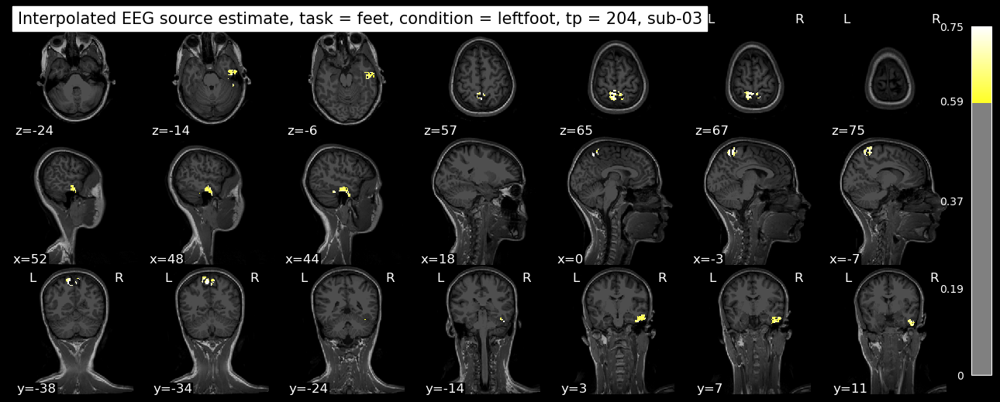

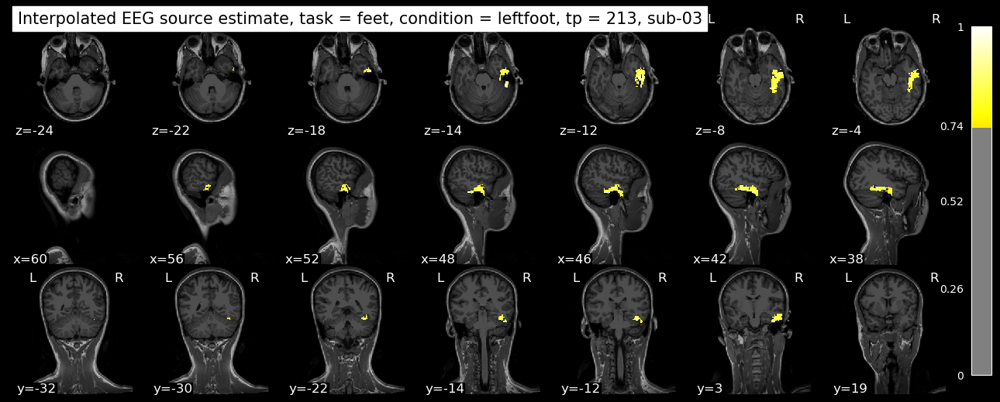

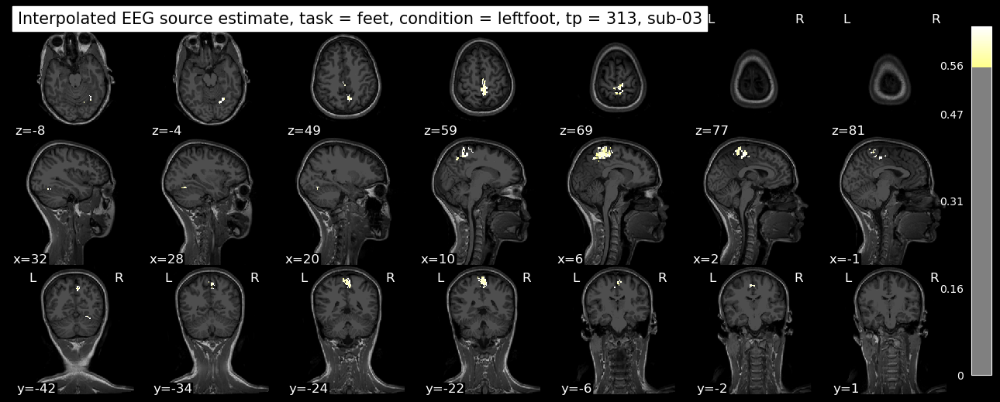

[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-03\eeg-esi\sub-03_task-feet_proc-raw_EEG_20240301_11285_rightfoot.icacorr.SpatialFilter.LAURA 8944 RGV.ZScoreVN.Vectorial Mean 82.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8944
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


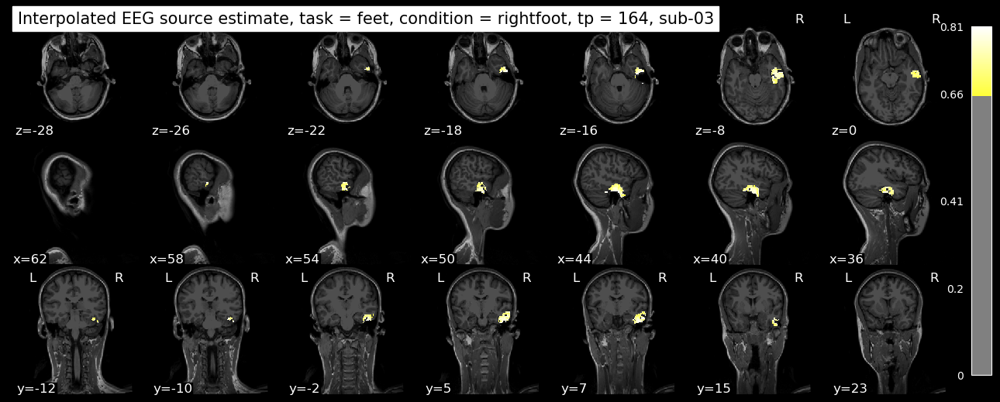

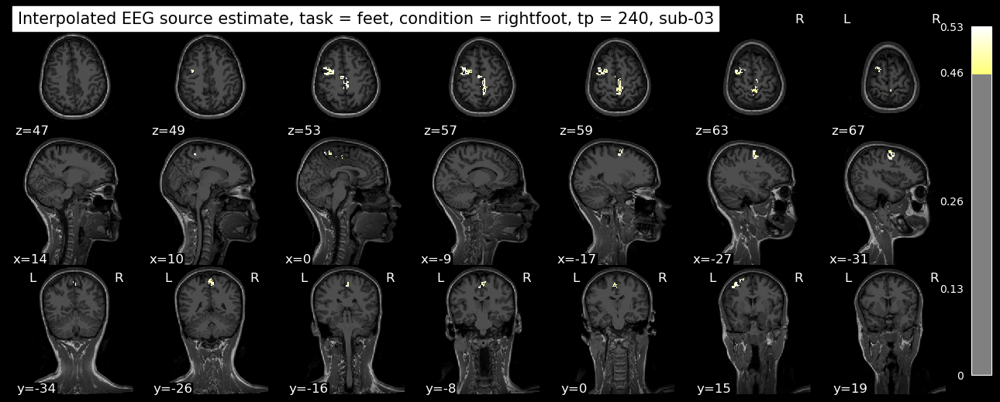

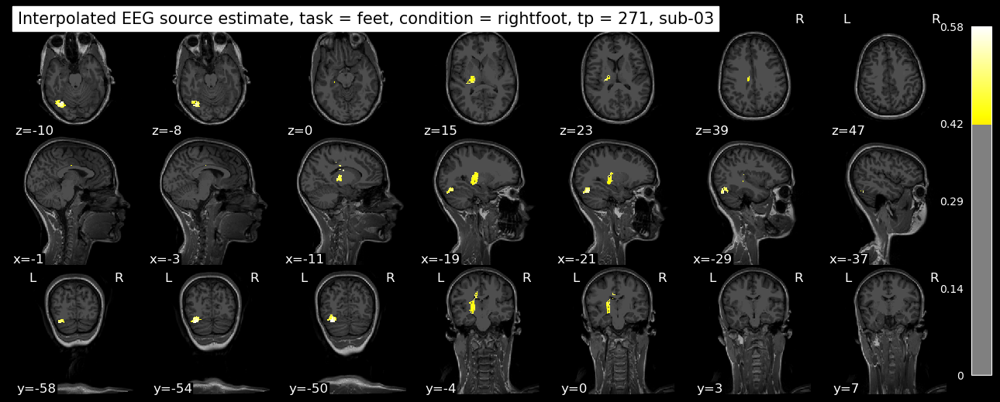

  
Analysis of task fing
[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-03\eeg-esi\sub-03_task-fing_proc-raw_EEG_20240301_11373_finger.icacorr.SpatialFilter.LAURA 8944 RGV.ZScoreVN.Vectorial Mean 99.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8944
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


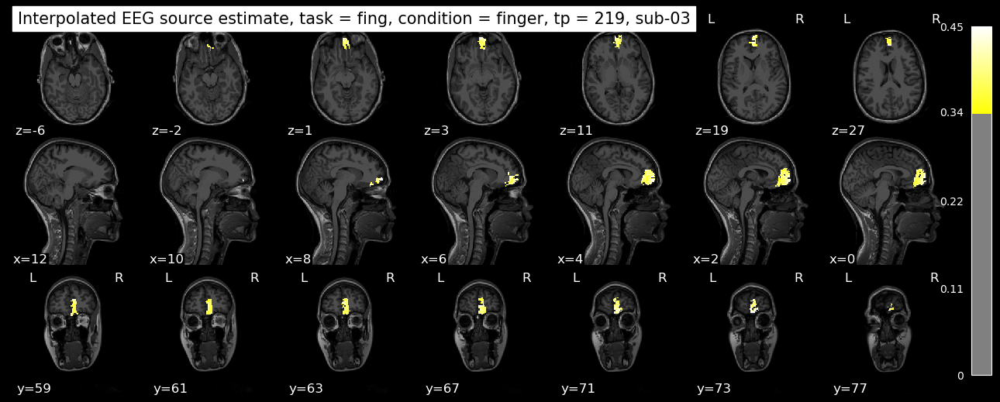

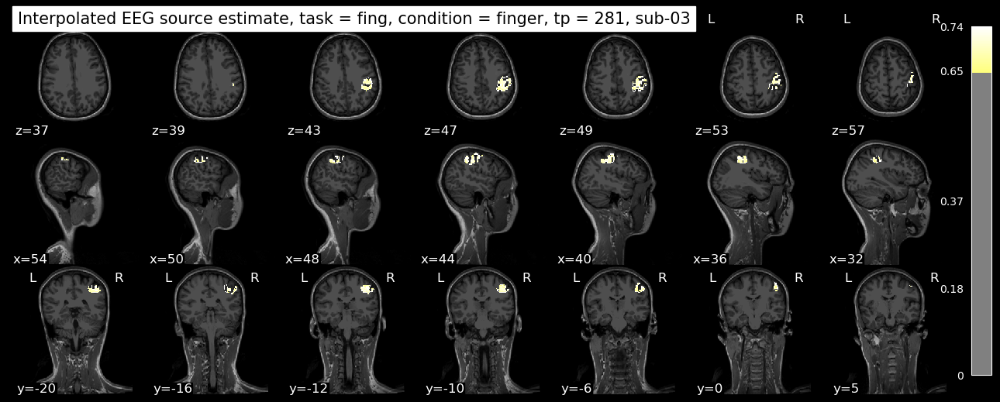

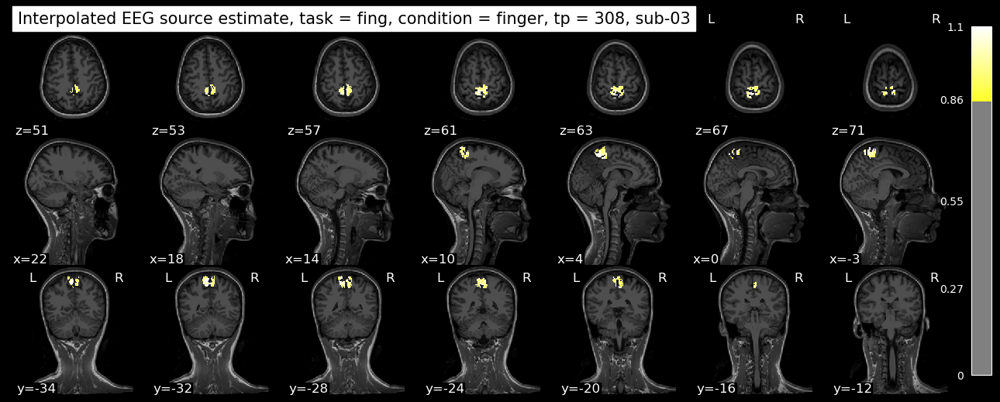

  
Analysis of task vis
[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-03\eeg-esi\sub-03_task-vis_proc-raw_EEG_20240301_11462_face.icacorr.SpatialFilter.LAURA 8944 RGV.ZScoreVN.Vectorial Mean 63.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8944
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


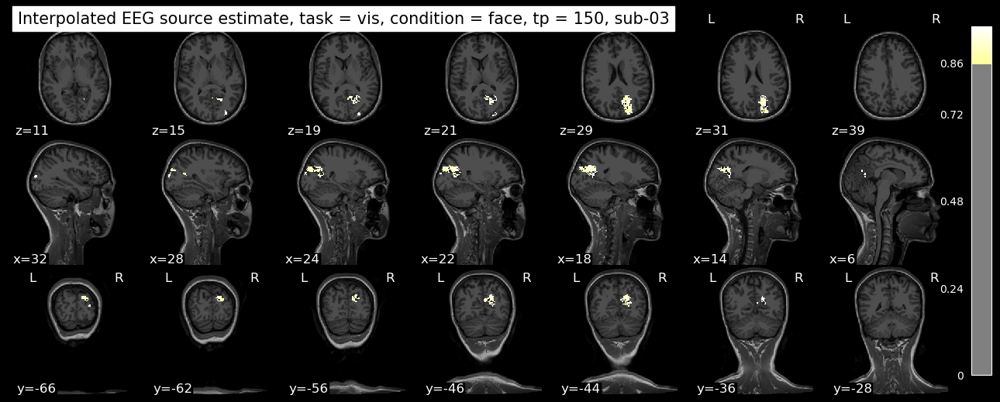

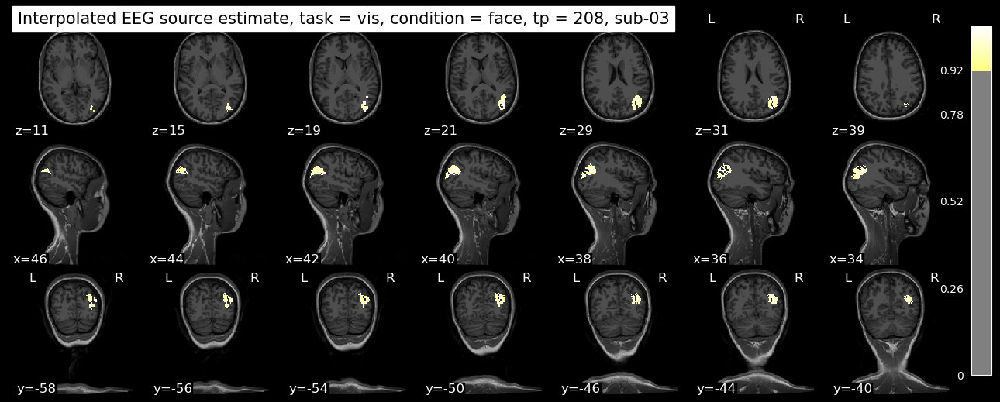

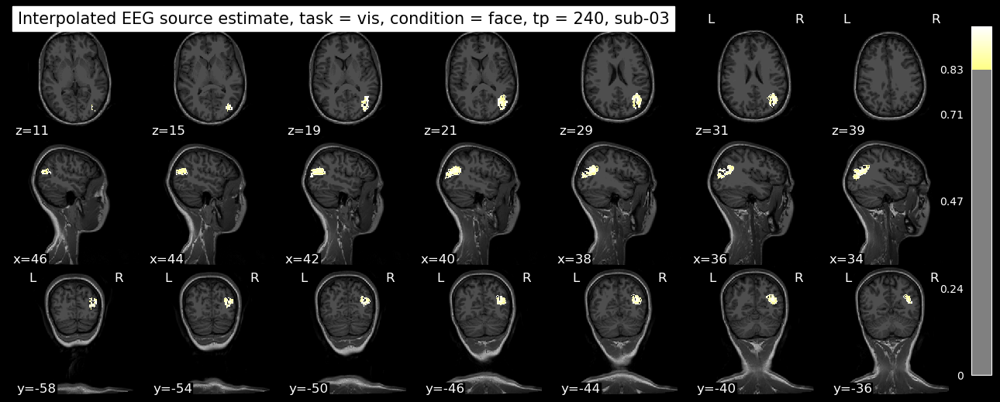

[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-03\eeg-esi\sub-03_task-vis_proc-raw_EEG_20240301_11462_scramble.icacorr.SpatialFilter.LAURA 8944 RGV.ZScoreVN.Vectorial Mean 63.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8944
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


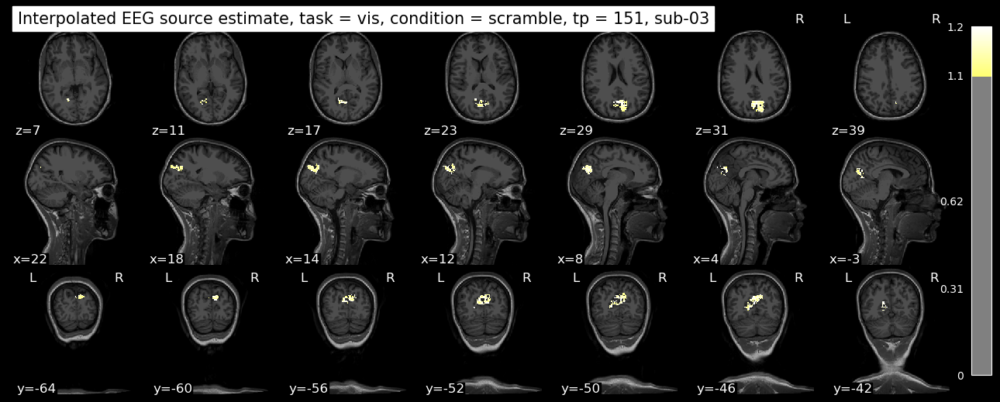

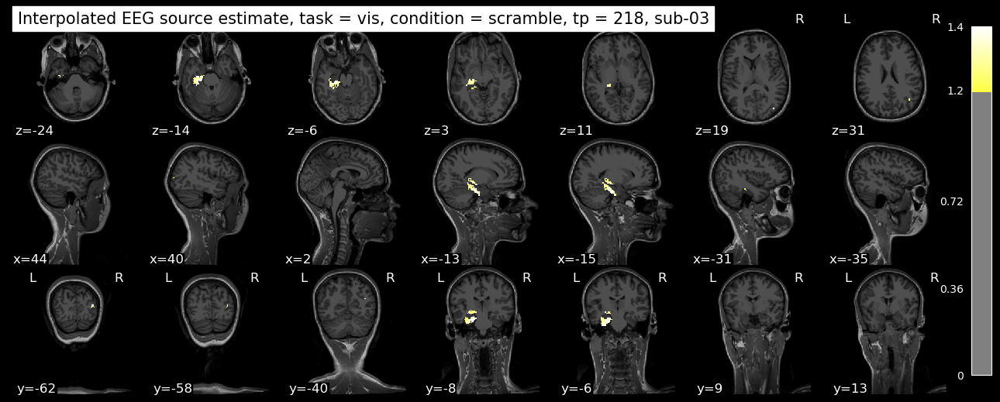

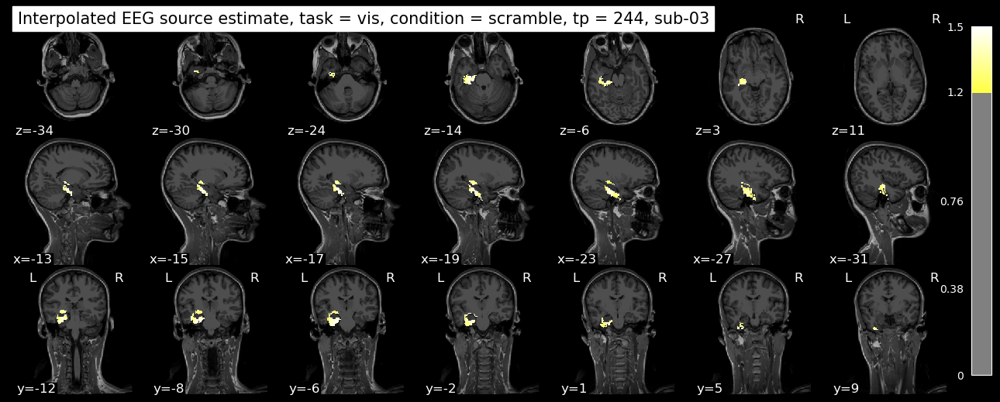

Processing sub-04
7.69 % completed
Estimated remaining time: 0.0 hours, 43.0 minutes.
  
Analysis of task aud
[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-04\eeg-esi\sub-04_task-aud_proc-raw_EEG_20240308_10183_sine.icacorr.SpatialFilter.LAURA 8821 RGV.ZScoreVN.Vectorial Mean 61.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8821
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


sizeof_hdr should be 348; set sizeof_hdr to 348


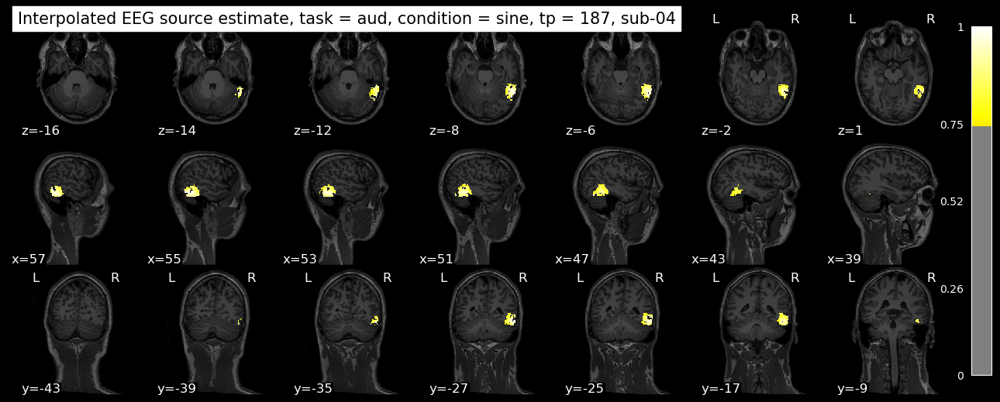

sizeof_hdr should be 348; set sizeof_hdr to 348


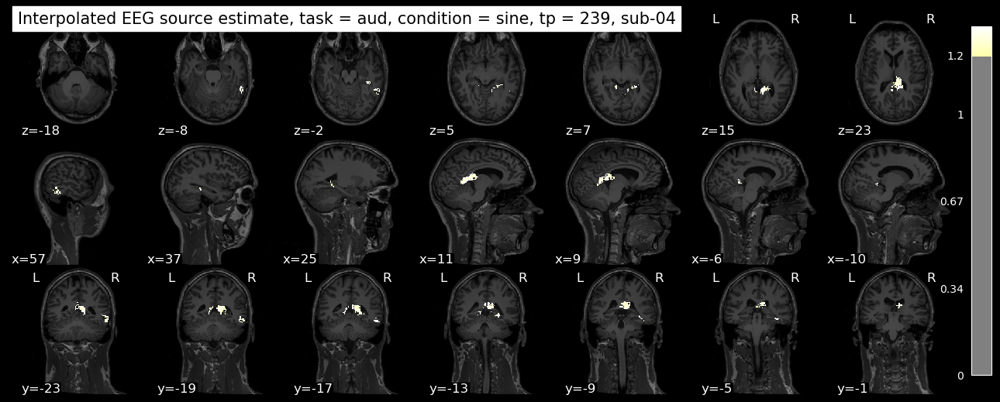

sizeof_hdr should be 348; set sizeof_hdr to 348


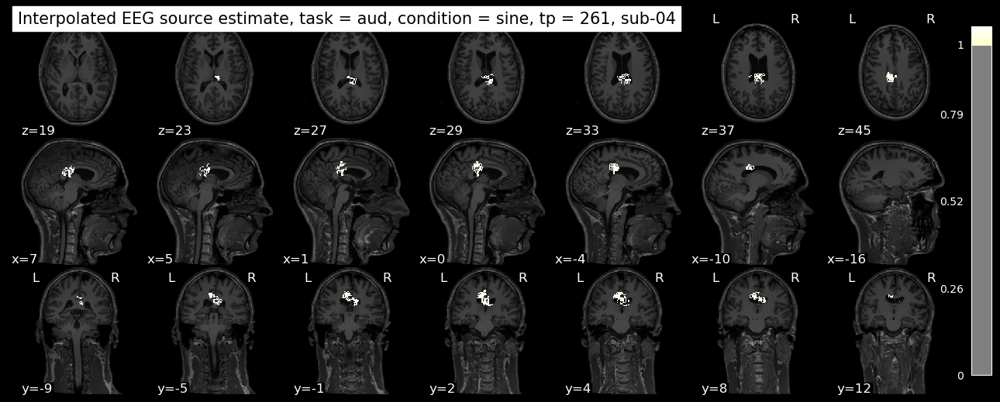

[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-04\eeg-esi\sub-04_task-aud_proc-raw_EEG_20240308_10183_piano1.icacorr.SpatialFilter.LAURA 8821 RGV.ZScoreVN.Vectorial Mean 71.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8821
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


sizeof_hdr should be 348; set sizeof_hdr to 348


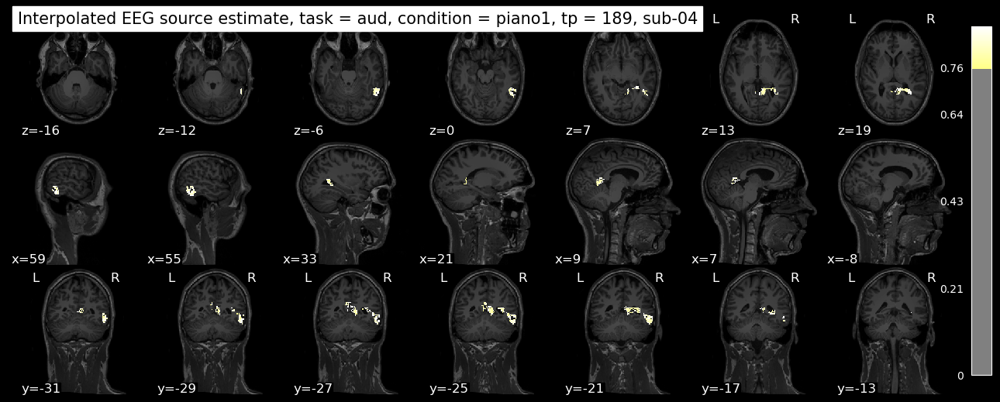

sizeof_hdr should be 348; set sizeof_hdr to 348


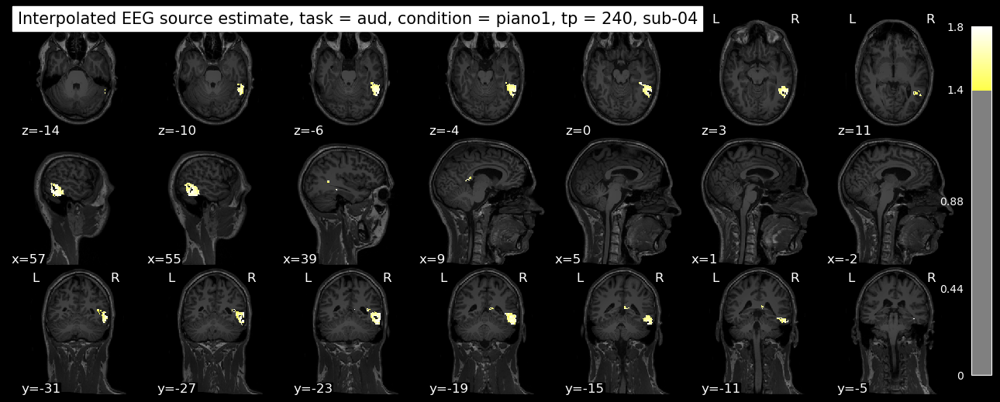

sizeof_hdr should be 348; set sizeof_hdr to 348


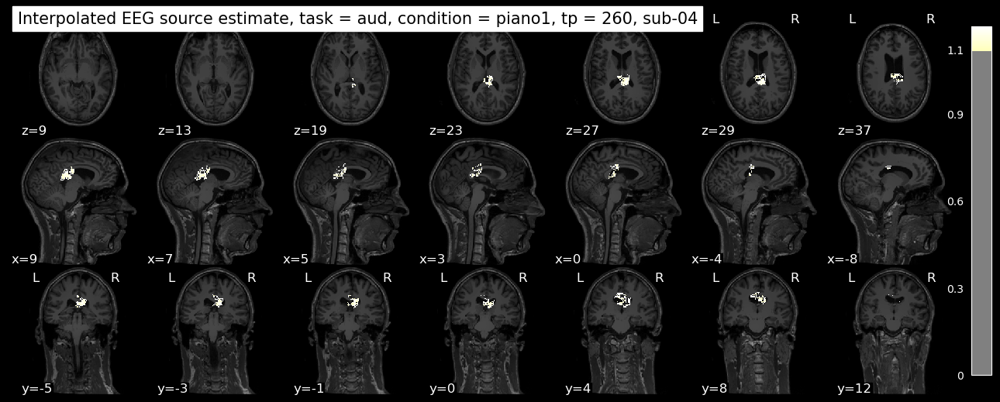

[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-04\eeg-esi\sub-04_task-aud_proc-raw_EEG_20240308_10183_piano4.icacorr.SpatialFilter.LAURA 8821 RGV.ZScoreVN.Vectorial Mean 71.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8821
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


sizeof_hdr should be 348; set sizeof_hdr to 348


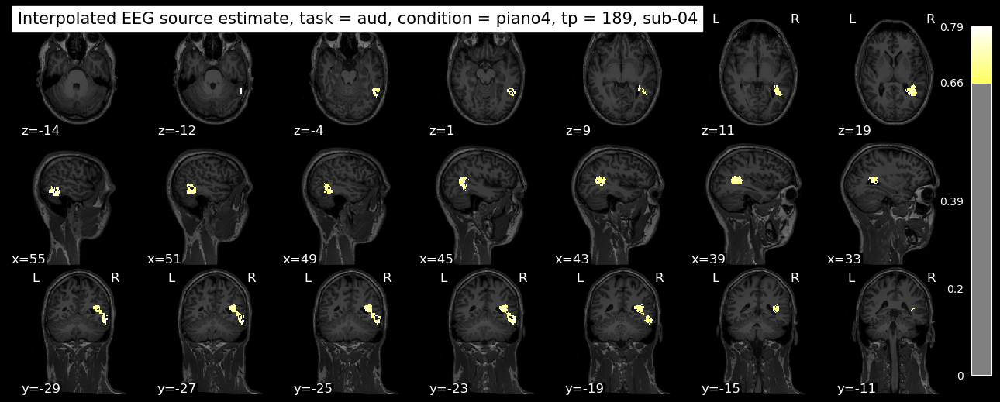

sizeof_hdr should be 348; set sizeof_hdr to 348


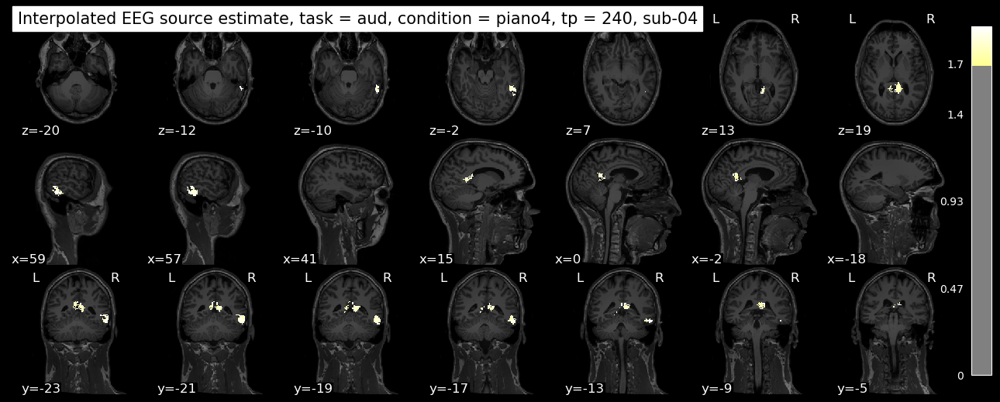

sizeof_hdr should be 348; set sizeof_hdr to 348


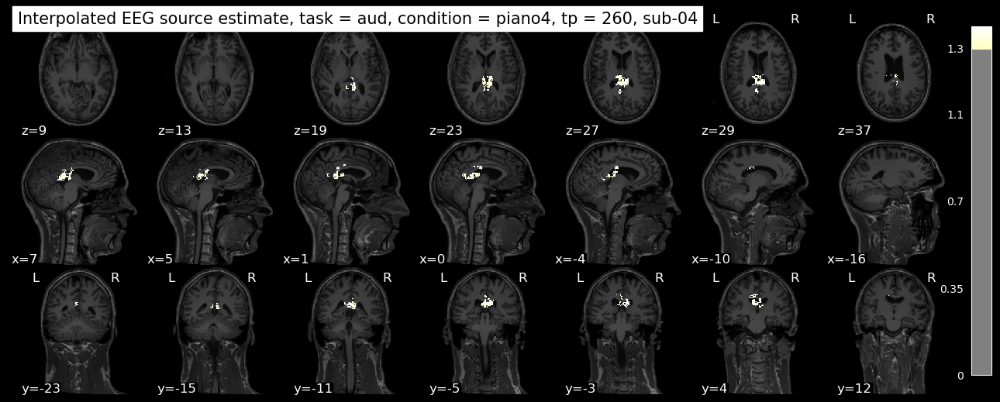

  
Analysis of task feet
[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-04\eeg-esi\sub-04_task-feet_proc-raw_EEG_20240308_10534_leftfoot.icacorr.SpatialFilter.LAURA 8821 RGV.ZScoreVN.Vectorial Mean 101.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8821
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


sizeof_hdr should be 348; set sizeof_hdr to 348


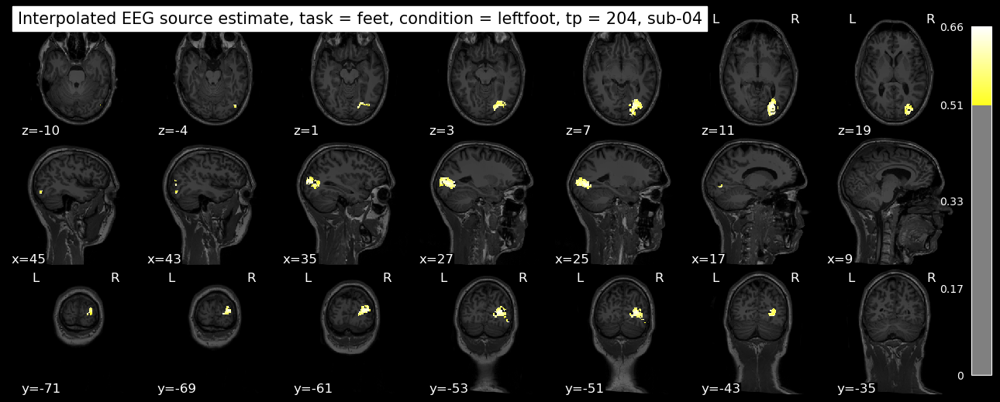

sizeof_hdr should be 348; set sizeof_hdr to 348


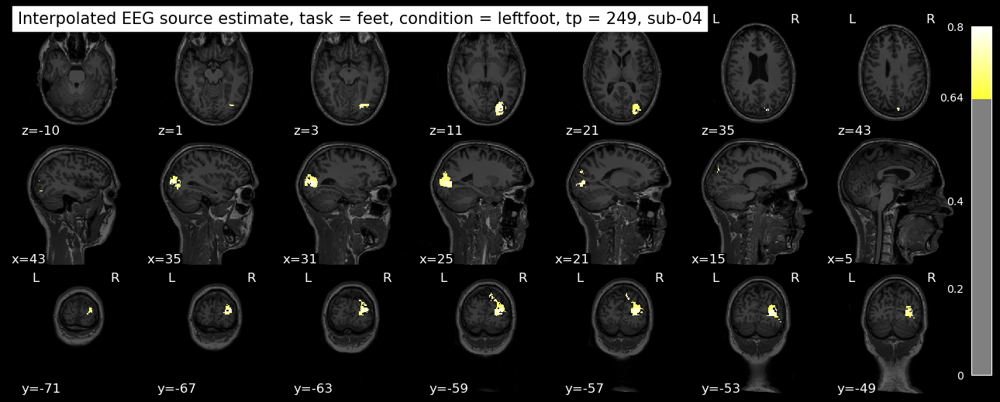

sizeof_hdr should be 348; set sizeof_hdr to 348


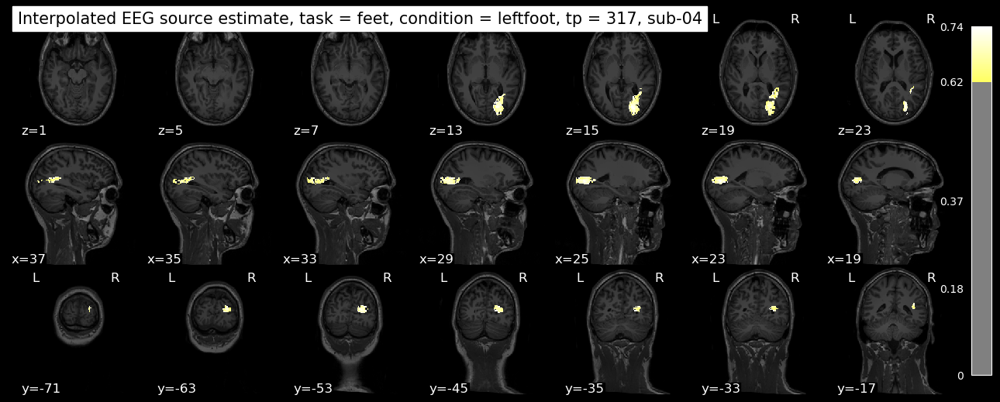

[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-04\eeg-esi\sub-04_task-feet_proc-raw_EEG_20240308_10534_rightfoot.icacorr.SpatialFilter.LAURA 8821 RGV.ZScoreVN.Vectorial Mean 103.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8821
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


sizeof_hdr should be 348; set sizeof_hdr to 348


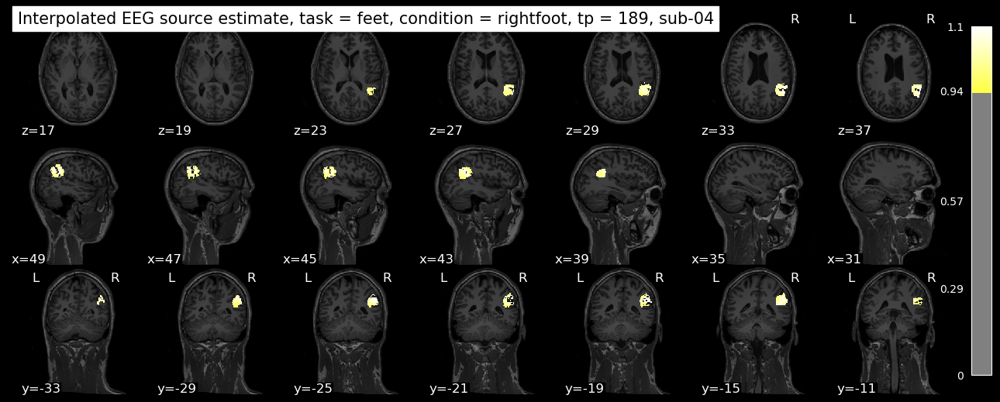

sizeof_hdr should be 348; set sizeof_hdr to 348


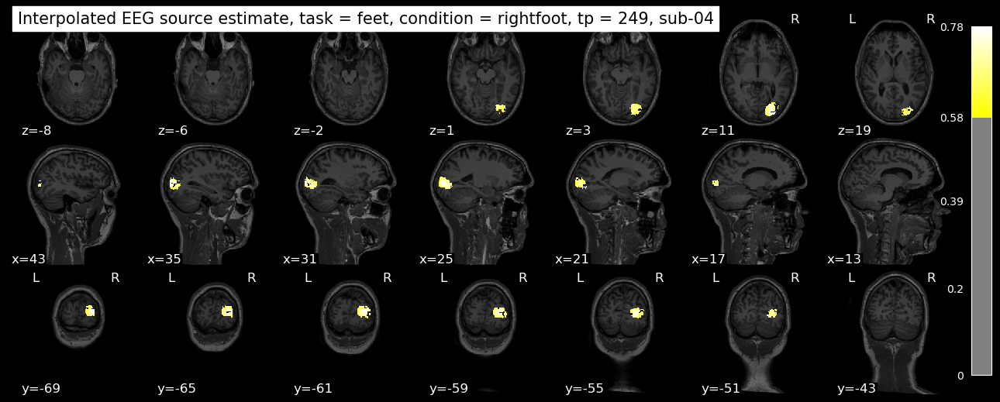

sizeof_hdr should be 348; set sizeof_hdr to 348


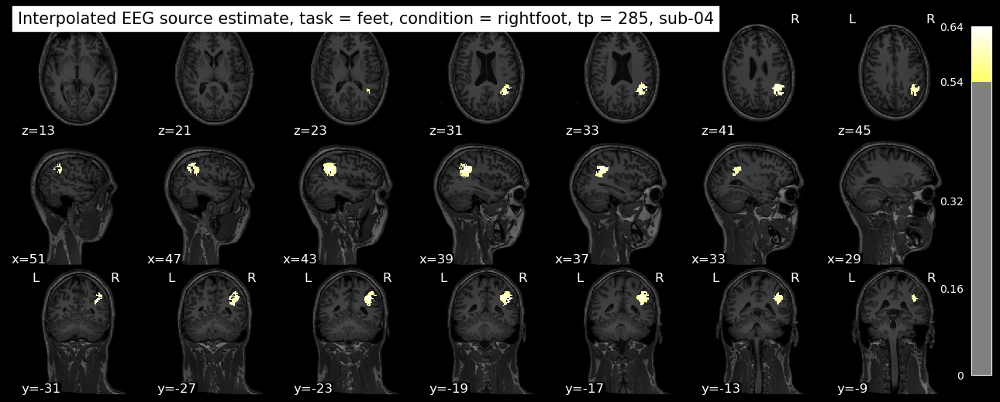

  
Analysis of task fing
[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-04\eeg-esi\sub-04_task-fing_proc-raw_EEG_20240308_10445_finger.icacorr.SpatialFilter.LAURA 8821 RGV.ZScoreVN.Vectorial Mean 115.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8821
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


sizeof_hdr should be 348; set sizeof_hdr to 348


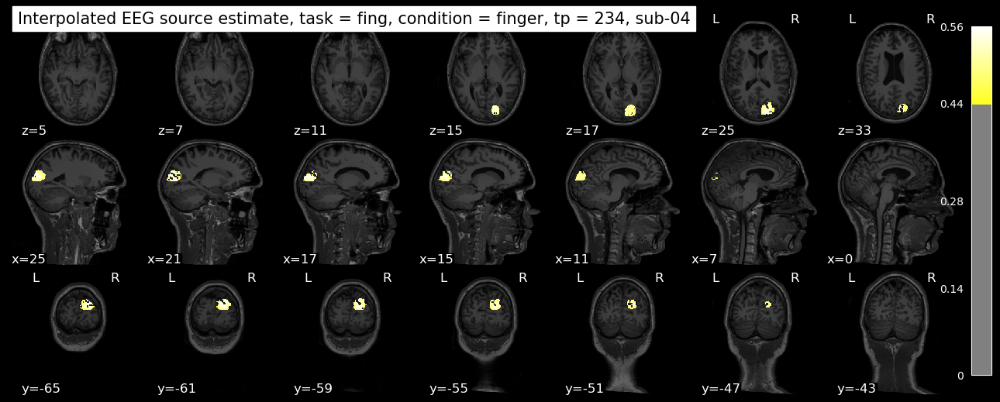

sizeof_hdr should be 348; set sizeof_hdr to 348


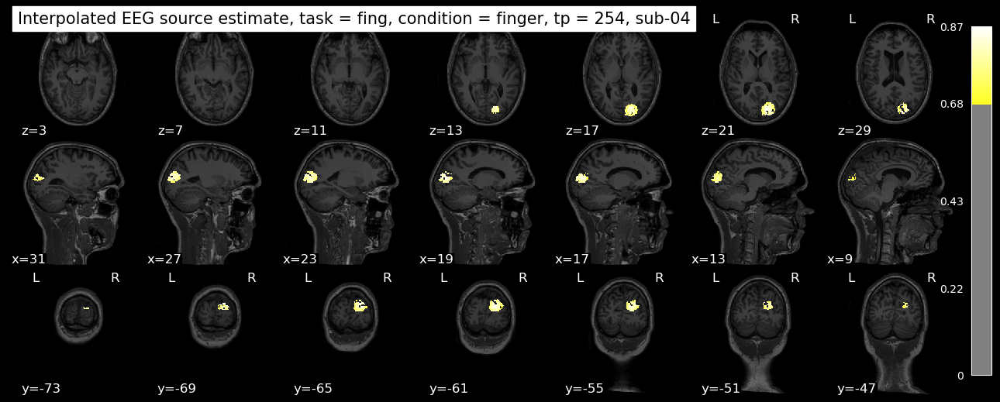

sizeof_hdr should be 348; set sizeof_hdr to 348


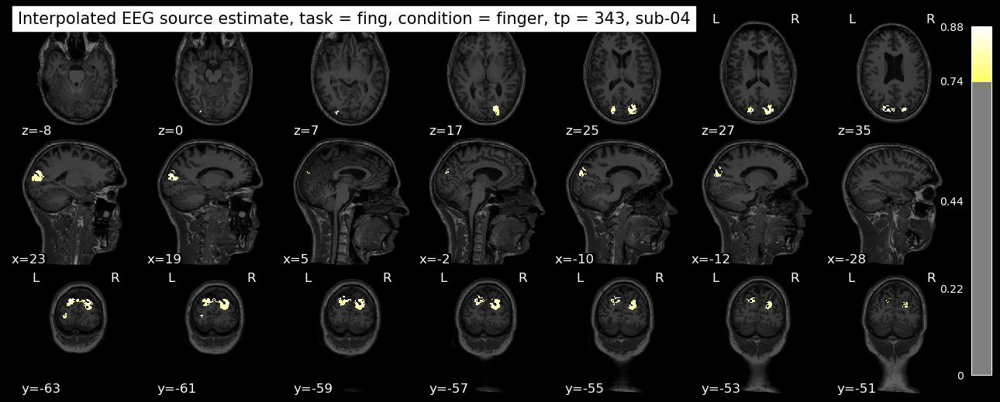

  
Analysis of task vis
[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-04\eeg-esi\sub-04_task-vis_proc-raw_EEG_20240308_10353_face.icacorr.SpatialFilter.LAURA 8821 RGV.ZScoreVN.Vectorial Mean 71.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8821
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


sizeof_hdr should be 348; set sizeof_hdr to 348


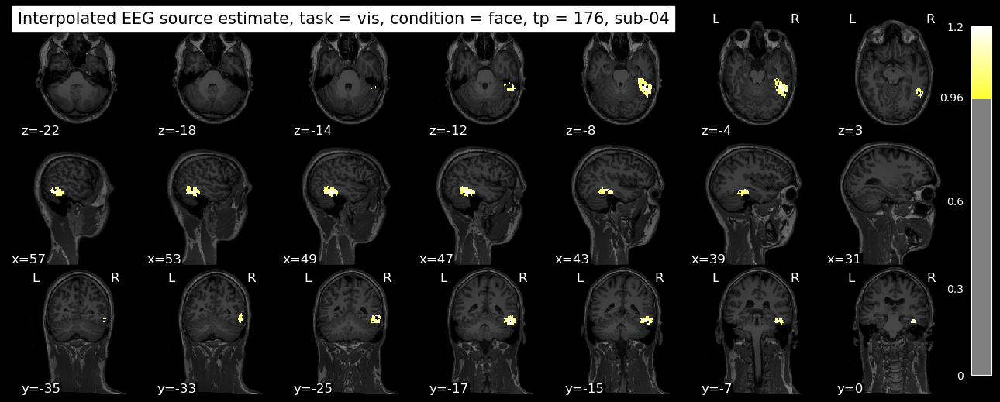

sizeof_hdr should be 348; set sizeof_hdr to 348


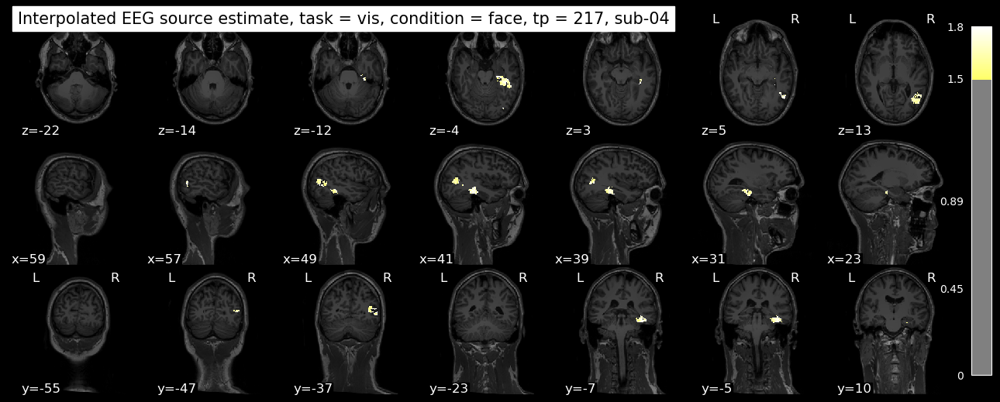

sizeof_hdr should be 348; set sizeof_hdr to 348


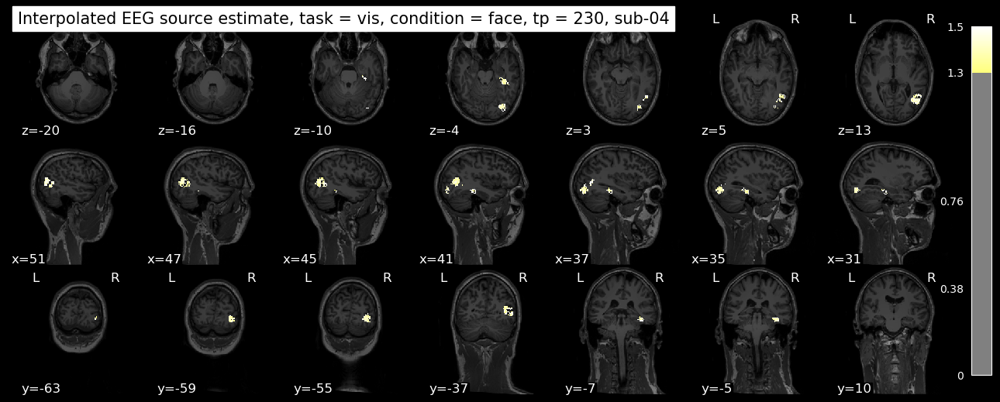

[source_estimate.read_ris] INFO: Reading I:\9008_CBT_HNP\MEG-EEG-fMRI\dataset_bids\derivatives\sub-04\eeg-esi\sub-04_task-vis_proc-raw_EEG_20240308_10353_scramble.icacorr.SpatialFilter.LAURA 8821 RGV.ZScoreVN.Vectorial Mean 72.ris
[source_estimate.read_ris] INFO: Reading Header...
[source_estimate.read_ris] INFO: IS type: RI01
[source_estimate.read_ris] INFO: n_solutionpoints: 8821
[source_estimate.read_ris] INFO: n_timeframes: 351
[source_estimate.read_ris] INFO: Samplimg frequency: 500.0
[source_estimate.read_ris] INFO: b'\x00'
[source_estimate.read_ris] INFO: Result of Inverse Solution computation is Vectorial


sizeof_hdr should be 348; set sizeof_hdr to 348


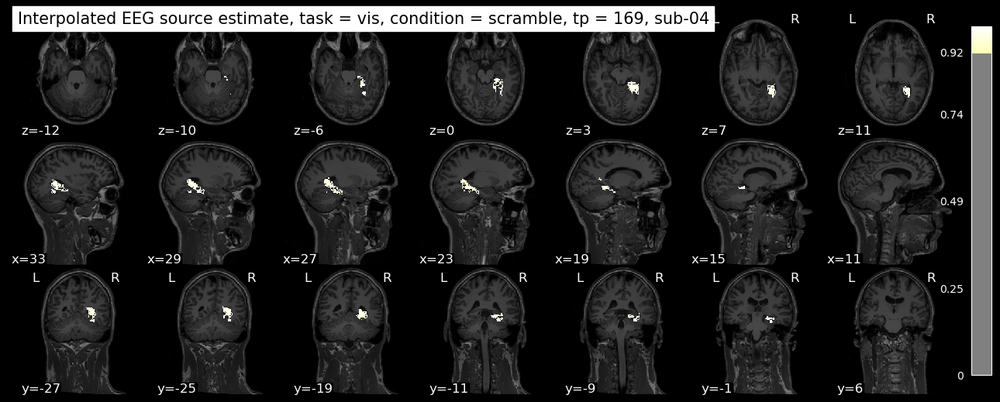

sizeof_hdr should be 348; set sizeof_hdr to 348


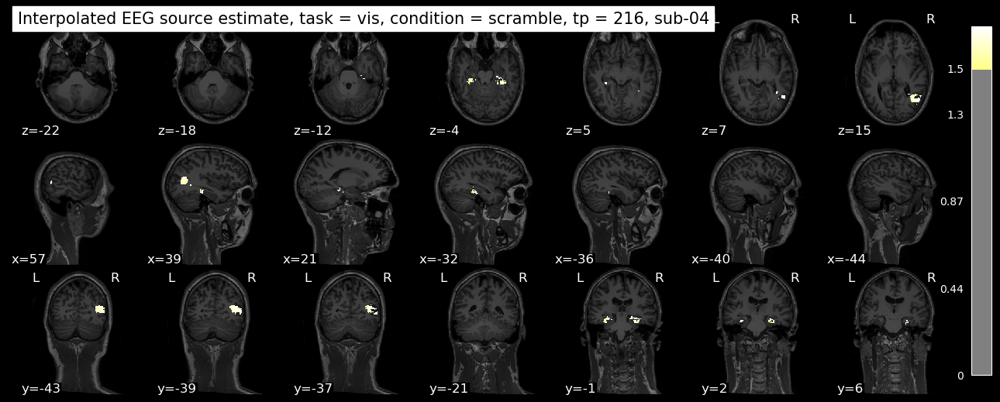

sizeof_hdr should be 348; set sizeof_hdr to 348


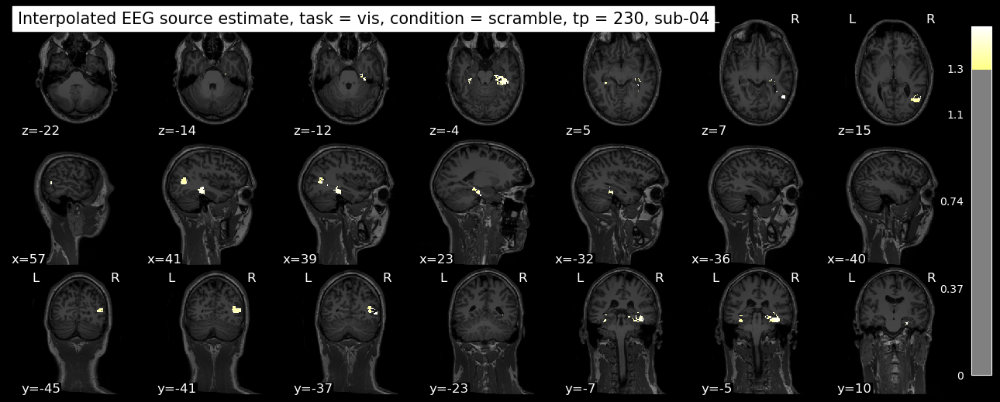

Processing sub-05
15.38 % completed
Estimated remaining time: 0.0 hours, 44.0 minutes.


FileNotFoundError: [Errno 2] No such file or directory: 'I:\\9008_CBT_HNP\\MEG-EEG-fMRI\\dataset_bids\\derivatives\\sub-05\\eeg-esi\\T1.BFC.spi'

In [7]:
# Start the time count to track the remaining computation time
start_time = time.time()

# Total number of subjects for progress tracking
tot_perf = len(subjects) 

# Threshold percentile
logger.info(f'Selected threshold top percentile alpha: {thres_param['EEG']['alpha']}')

# Minimum cluster size
logger.info(f'Selected cluster size > {thres_param['EEG']['cluster_thresh']}')

# Loop through subjects
for count_perf, sub in enumerate(subjects):
    try:
        logger.info(f'Processing {sub}')
        print(f'Processing {sub}')

        trackprogress(count_perf, tot_perf, start_time, logger)

        sub_derivatives_dir = Path(local_dir) / 'derivatives' / sub 
        
        # Define the path to the ESI for this subject
        path_sub_data = sub_derivatives_dir / 'eeg-esi' 
        path_source_space = path_sub_data / "T1.spi"
        
        # Load the source space
        logger.info(f'  Loading source space from: {path_source_space}')
        try:
            source_space = read_spi(path_source_space)
            # Path to the anatomical image
            anat_path = path_sub_data / "T1.nii"
            logger.info(f'  Loading anatomical image from: {anat_path}')
            try:
                anat_img = nib.load(anat_path)
            except Exception as e:
                logger.error(f'  Failed to load the anatomical image from: {anat_path}. Error: {e}')
                print(f'  Failed to load the anatomical image from: {anat_path}. Error: {e}')
                raise
                
        except Exception as e:
            logger.warning(f'  Failed to load source space from: {path_source_space}. Error: {e}')
            path_source_space = path_sub_data / "T1.BFC.spi"
            logger.info(f'  Loading source space from: {path_source_space}')
            try:
                source_space = read_spi(path_source_space)
                # Path to the anatomical image
                anat_path = path_sub_data / "T1.BFC.nii"
                logger.info(f'  Loading anatomical image from: {anat_path}')
                try:
                    anat_img = nib.load(anat_path)
                except Exception as e:
                    logger.error(f'  Failed to load the anatomical image from: {anat_path}. Error: {e}')
                    raise
            except Exception as e:
                logger.error(f'  Failed to load source space from: {path_source_space}. Error: {e}')
                raise
    
        coordinates_sspace = source_space.coordinates

        # Define directories and paths
        brainmask_outdir = sub_derivatives_dir / 'anat'
        brainmask_path = brainmask_outdir / f"{sub}_brainmask_desc-resamp2fmri.nii.gz"
    
        if not brainmask_path.exists():
            logger.info(f'  Brain mask not found, creating a new one.')
            # Create a brain mask from the ribbon mask if it doesn't exist
            brain_mask = process_ribbon(sub, local_dir, brainmask_outdir)
            
            # Load fMRI data to obtain the target affine and shape for resampling
            fmri_data_outdir =  sub_derivatives_dir / 'func' / 'task-aud'
            path_fmri_data = fmri_data_outdir / f"{sub}_task-aud_contrast-sine_desc-stat-t_statmap.nii.gz"
            logger.info(f'  Loading fMRI data from: {path_fmri_data}')
            fmri_data_img = nib.load(path_fmri_data)
        
            logger.info(f'  Resampling brain mask to match fMRI resolution.')
            resample_brain_mask = resample_and_threshold_image(
                brain_mask, fmri_data_img.affine, fmri_data_img.shape[:3], brainmask_path
            )
            # Free memory
            del brain_mask, fmri_data_outdir, path_fmri_data, fmri_data_img
        else:
            logger.info(f'  Loading existing resampled brain mask from: {brainmask_path}')
            resample_brain_mask = nib.load(brainmask_path)
        
           
        # Loop through tasks
        for task in tasks_conditions.keys():
            print(f"  \nAnalysis of task {task}")
            logger.info(f"  \nAnalysis of task {task}")
            try:
                outdir =  sub_derivatives_dir / 'eeg' / 'stc_interpolated' / f'task-{task}'
                outdir.mkdir(parents=True, exist_ok=True)
                
                # Loop through conditions
                for condition in tasks_conditions[task]:
                    logger.info(f'    Processing condition: {condition}')
                    try:
                        pattern = path_sub_data / f"{sub}_task-{task}_proc-raw_EEG_*_*_{condition}.icacorr.SpatialFilter.{stc_algo} * RGV.ZScoreVN.Vectorial Mean *.ris"
                        matching_files = list(glob.glob(str(pattern)))
                
                        if len(matching_files) == 1: 
                            esi_data_path = matching_files[0]
                        elif len(matching_files) > 1:
                            raise ValueError(f'Multiple matching files found, it should be only one: {matching_files}.')
                        else:
                            raise ValueError(f'No file found matching the pattern {pattern}.')
                
                        logger.info(f'      Loading source estimate from: {esi_data_path}')
                        source_estimate = read_ris(esi_data_path)
                
                        # Found the windows for this condition
                        if isinstance(task_tp[task], dict):
                            windows = task_tp[task][condition]
                        else:
                            windows = task_tp[task]
                            
                        # Loop through the windows of interest    
                        for window in windows:
                            try:
                                logger.info(f'      Processing window: {window}')
                                values_window = np.linalg.norm(source_estimate.sources_tc[:, :, window[0]:window[1]], axis=1)
                                sestim_tp_values, tp = get_poa_timepoint_sestim(values_window, window)
                    
                                logger.info(f'        Interpolating to anatomical space at time point: {tp}')
                                interpolated_data = interpolate_sestim_to_voxel_space(anat_img, coordinates_sspace, sestim_tp_values)
                                interpolated_img = nib.Nifti1Image(interpolated_data, anat_img.affine, anat_img.header)
                                
                                interpolated_path = outdir / f"{sub}_task-{task}_condition-{condition}_desc-eeg-stcinterpol_tp-{tp}_stat-{stc_algo}_statmap.nii.gz"
                                nib.save(interpolated_img, interpolated_path)
                                logger.info(f'        Saved interpolated image to: {interpolated_path}')
                    
                                logger.info(f'        Resampling the interpolated image.')
                                interpolated_img_resamp = resample_img(interpolated_img, resample_brain_mask.affine, resample_brain_mask.shape, interpolation = 'linear')
                                interpolated_path_resamp = outdir / f"{interpolated_path.with_suffix('').stem}_resamp.nii.gz"
                                nib.save(interpolated_img_resamp, interpolated_path_resamp)
                                
                                logger.info(f'        Masking the resampled image.')
                                brain_mask_nifti_masker = NiftiMasker(mask_img=resample_brain_mask)
                                interpolated_img_masked = brain_mask_nifti_masker.inverse_transform(
                                    brain_mask_nifti_masker.fit_transform(interpolated_img_resamp)
                                )
                                interpolated_path_masked = outdir / f"{interpolated_path_resamp.with_suffix('').stem}_masked.nii.gz"
                                nib.save(interpolated_img_masked, interpolated_path_masked)
                    
                                logger.info(f'        Thresholding at the top alpha percentile.')
                                threshold = find_top_alpha_percent_threshold(interpolated_img_masked.get_fdata(), thres_param['EEG']['alpha'])
                                interpolated_img_thres, _ = threshold_stats_img(interpolated_img_masked, threshold = threshold, cluster_threshold = thres_param['EEG']['cluster_thresh'], height_control = None)
                    
                                # Plot the thresholded image
                                plot_stat_map(
                                    interpolated_img_thres, anat_img, threshold = threshold, display_mode="mosaic",
                                    cmap=plt.cm.hot, title=f"Interpolated EEG source estimate, task = {task}, condition = {condition}, tp = {tp}, {sub}"
                                )
                                plt.show()
                                plt.close()
                    
                                # Save the thresholded image
                                interpolated_path_thres = outdir / f"{interpolated_path_masked.with_suffix('').stem}_topercent-{thres_param['EEG']['alpha']}_cluster-{thres_param['EEG']['cluster_thresh']}.nii.gz"
                
                                # Add a description the the image header with the threshold value
                                description = f"{condition}, threshold = {round(threshold, 3)}, alpha = {thres_param['EEG']['alpha']}, n > {thres_param['EEG']['cluster_thresh']}".encode('utf-8')[:80]
                                interpolated_img_thres.header['descrip'] = description
                                nib.save(interpolated_img_thres, interpolated_path_thres)
                                logger.info(f'        Saved thresholded image to: {interpolated_path_thres}')
                                
                            except Exception as e:
                                logger.error(f"      Error processing window {window}: {str(e)}")
                                raise e
         
                    except Exception as e:
                        logger.error(f"    Error processing condition {condition}: {str(e)}")
                        raise e
            except Exception as e:
                logger.error(f"  Error processing task {task}: {str(e)}")
                raise e
    except Exception as e:
        logger.error(f"Error processing subject {sub}: {str(e)}")
        raise e
    
logger.info("Processing completed.")